The code is a collection of functions for performing image processing tasks. 

These tasks include histogram equalization, histogram matching, convolution using spatially separable filters, noise addition and filtering using mean, median and Gaussian filters. 
There are also functions for plotting results and evaluating the performance of the algorithms. 


Below is an explanation of each of the functions in the code.

In [236]:
import cv2
import time
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
from skimage.filters import median
from scipy.signal import convolve2d
from skimage.util import random_noise
from skimage import img_as_float, img_as_ubyte, measure

In [2]:
!wget https://eeweb.engineering.nyu.edu/~yao/EL5123/image/barbara_gray.bmp -O barbara.png


--2023-04-04 07:16:05--  https://eeweb.engineering.nyu.edu/~yao/EL5123/image/barbara_gray.bmp
Resolving eeweb.engineering.nyu.edu (eeweb.engineering.nyu.edu)... 128.238.64.104
Connecting to eeweb.engineering.nyu.edu (eeweb.engineering.nyu.edu)|128.238.64.104|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 263224 (257K) [image/bmp]
Saving to: ‘barbara.png’

barbara.png         100%[===================>] 257.05K  --.-KB/s    in 0.1s    

2023-04-04 07:16:05 (2.10 MB/s) - ‘barbara.png’ saved [263224/263224]



In [237]:
!wget https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp=share_link -O lena.png

--2023-04-04 12:08:56--  https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp=share_link
Resolving drive.google.com (drive.google.com)... 74.125.124.100, 74.125.124.102, 74.125.124.138, ...
Connecting to drive.google.com (drive.google.com)|74.125.124.100|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://accounts.google.com/ServiceLogin?service=wise&passive=1209600&continue=https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp%3Dshare_link&followup=https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp%3Dshare_link [following]
--2023-04-04 12:08:56--  https://accounts.google.com/ServiceLogin?service=wise&passive=1209600&continue=https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp%3Dshare_link&followup=https://drive.google.com/file/d/1Xax_kNjhKF7hXtTFP0oVlFgYxqmjX3JC/view?usp%3Dshare_link
Resolving accounts.google.com (accounts.google.com)... 173.194.198.

In [3]:
!wget https://upload.wikimedia.org/wikipedia/commons/0/08/Unequalized_Hawkes_Bay_NZ.jpg -O Unequalized_Hawkes_Bay_NZ.jpg

--2023-04-04 07:16:09--  https://upload.wikimedia.org/wikipedia/commons/0/08/Unequalized_Hawkes_Bay_NZ.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 208.80.153.240, 2620:0:861:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|208.80.153.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 110895 (108K) [image/jpeg]
Saving to: ‘Unequalized_Hawkes_Bay_NZ.jpg’

Unequalized_Hawkes_ 100%[===================>] 108.30K  --.-KB/s    in 0.06s   

2023-04-04 07:16:09 (1.65 MB/s) - ‘Unequalized_Hawkes_Bay_NZ.jpg’ saved [110895/110895]



In [226]:
# Function for loading an image
def load_image(image_path):
  """
  This function reads an image from a file using OpenCV and converts it to grayscale. 
  It takes as input the path to the image file and returns the grayscale image.
  """

  img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
  
  return img

# Function for plotting an image and its histogram
def plot_image_and_histogram(img, title):
  """
  This function plots an image and its corresponding histogram side by side. 
  It takes as input the image and a title for the plot.
  """

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
  fig.suptitle(title)
  ax1.imshow(img, cmap='gray')
  ax2.hist(img.ravel(), bins=256, range=(0, 256))
  plt.show()

# Task 1: Histogram Equalization
def histogram_equalization(img):
  """
  This function performs histogram equalization on a grayscale image. 
  It takes as input the image and returns the equalized image and its corresponding histogram.
  """


  hist, bins = np.histogram(img.flatten(), 256, [0, 256])
  
  cdf = hist.cumsum()
  cdf_normalized = cdf * hist.max() / cdf.max()
  
  img_equalized = np.interp(img.flatten(), bins[:-1], cdf_normalized).reshape(img.shape)
  hist_eq, bins_eq = np.histogram(img_equalized.flatten(), 256, [0, 256])
  
  return img_equalized, hist_eq

# Task 2: Histogram Matching
def histogram_matching(img, ref_img):  
  '''
  This function performs histogram matching between a grayscale image and a reference grayscale image. 
  It takes as input the image to be matched and the reference image, and returns the matched image and its corresponding histogram.
  '''

  hist, bins = np.histogram(img.flatten(), 256, [0, 256])
  cdf = hist.cumsum()
  cdf_normalized = cdf * hist.max() / cdf.max()

  ref_hist, ref_bins = np.histogram(ref_img.flatten(), 256, [0, 256])
  ref_cdf = ref_hist.cumsum()
  ref_cdf_normalized = ref_cdf * ref_hist.max() / ref_cdf.max()

  T = np.zeros(256)
  for i in range(256):
      j = np.argmin(np.abs(cdf_normalized - ref_cdf_normalized[i]))
      T[i] = j

  img_matched = np.interp(img.flatten(), bins[:-1], T).reshape(img.shape)
  hist_match, bins_match = np.histogram(img_matched.flatten(), 256, [0, 256])

  return img_matched, hist_match

# Task 3: Separable Filter
def convolve(image, kernel):
  '''
  This function performs convolution between an image and a kernel. 
  It takes as input the image and the kernel, and returns the convolved image 
  and the number of operations performed during the convolution.

  '''
  
  num_operations = image.shape[0] * image.shape[1] * kernel.shape[0] * kernel.shape[1]
  
  return signal.convolve2d(image, kernel, mode='same', boundary='fill', fillvalue=0), num_operations

def simple_convolution(img, kernel):
  '''
  This function performs convolution between an image and a kernel using the convolve function defined above. 
  It takes as input the image and the kernel, and returns the convolved image and the number of operations performed during the convolution.
  '''

  result, num_operations = convolve(img, kernel)
  
  return result, num_operations

def spatial_separable_convolution(img, kernel1, kernel2):
  '''
  This function performs convolution between an image and two spatially separable kernels. 
  It takes as input the image and the two kernels, and returns the convolved image and the number of operations performed during the convolution.
  '''

  img_h, num_operations1 = convolve(img, kernel1)
  img_hv, num_operations2 = convolve(img_h, np.transpose(kernel2))
  total_num_operations = num_operations1 + num_operations2
  
  return img_hv, total_num_operations

def perform_convolution(image, kernel_3x3, kernel_3x1, kernel_1x3):
  '''
  This function performs convolution on an image using a 3x3 kernel and two spatially separable 3x1 and 1x3 kernels. 
  It compares the performance of the simple convolution and the spatially separable convolution and plots the results.

  '''

  start_time = time.time()
  simple_conv, num_operations_simple_conv = simple_convolution(image, kernel_3x3)
  elapsed_time = time.time() - start_time
  print("Elapsed time (simple):", elapsed_time)
  print(f"Number of operations for simple convolution: {num_operations_simple_conv}")

  start_time = time.time()
  spatial_separable_conv, num_operations_spatial_separable_conv = spatial_separable_convolution(image, kernel_3x1, kernel_1x3)
  elapsed_time = time.time() - start_time
  print("\nElapsed time (separable):", elapsed_time)
  print(f"Number of operations for spatial separable convolution: {num_operations_spatial_separable_conv}")

  plot_separable_filter(image, simple_conv, spatial_separable_conv)

# Task 4: Create Noisy Images and Estimate SNR and Noise Distribution
def add_noise(image, noise_type, var):
  '''
  This function adds noise to a grayscale image. 
  It takes as input the image, the type of noise to be added (Gaussian or salt and pepper), 
  and the variance of the noise. It returns the noisy image.
  '''

  image_float = img_as_float(image)
  
  if noise_type == 'gaussian':
    noisy_image = random_noise(image_float, mode='gaussian', var=var)
  elif noise_type == 'salt_pepper':
    noisy_image = random_noise(image_float, mode='s&p', amount=var)
  
  noisy_image = img_as_ubyte(noisy_image)
  
  return noisy_image

def estimate_snr(image, noisy_image):
  '''
  This function estimates the signal-to-noise ratio (SNR) of a noisy image compared to the original image. 
  It takes as input the original image and the noisy image, and returns the SNR in decibels (dB).

  '''

  noise = noisy_image.astype(float) - image.astype(float)
  noise_var = np.var(noise)
  signal_var = np.var(image.astype(float))
  snr = 10 * np.log10(signal_var / noise_var)
  return snr

# Task 5: Simple Mean Filter with size as a parameter
def simple_mean_filter(image, size):
  '''
  This function performs simple mean filtering on a grayscale image. 
  It takes as input the image and the size of the filter, and returns the filtered image.
  '''

  kernel = np.ones((size, size), np.float32) / (size ** 2)
  filtered_image = cv2.filter2D(image, -1, kernel)
  
  return filtered_image

# Task 6: Median Filter 
def median_filter(image, size): 
  '''
  This function performs median filtering on a grayscale image. 
  It takes as input the image and the size of the filter, and returns the filtered image.

  '''

  filtered_image = cv2.medianBlur(image, size) 
  
  return filtered_image

# Task 7: Gaussian Filter 
def gaussian_filter(image, size, sigma): 
  '''
  This function performs Gaussian filtering on a grayscale image. 
  It takes as input the image, the size of the filter, and the standard deviation of the Gaussian function used to generate the filter. 
  It returns the filtered image.

  '''

  kernel = cv2.getGaussianKernel(size, sigma) 
  filtered_image = cv2.filter2D(image, -1, kernel * kernel.T) 
  filtered_image = normalize(filtered_image)
  
  return filtered_image

def gaussian_filter_1(image, size, sigma):
  '''
  This function is an alternative implementation of Gaussian filtering using a pre-defined kernel. 
  It takes as input the image, the size of the filter, and the standard deviation of the Gaussian function used to generate the filter. 
  It returns the filtered image.

  '''

  kernel = create_gaussian_kernel(size, sigma)
  filtered = convolve2d(image, kernel, mode='same')
  filtered = normalize(filtered)

  return filtered

def create_gaussian_kernel(size, sigma):
  '''
  This function generates a Gaussian kernel of a given size and standard deviation sigma. 
  The Gaussian kernel is a 2D matrix of size (size, size) that contains values that represent the weights of each pixel in the kernel. 
  The values in the kernel are calculated based on the Gaussian function, which is a probability density function that is used to model random variables.
  '''

  x, y = np.meshgrid(np.linspace(-1, 1, size), np.linspace(-1, 1, size))
  d = np.sqrt(x*x + y*y)

  kernel = np.exp(-1*(d*d) / (2*sigma*sigma))
  kernel = kernel / np.sum(kernel)
  
  return kernel

def normalize(image):
  '''
  This function takes as input an image and returns a normalized version of the image. 
  Normalization is a process of adjusting the pixel values of an image so that they lie within a specified range. 
  In this function, the pixel values are scaled to be between 0 and 1 by dividing each pixel value by the maximum pixel value in the image.
  '''

  min_val = np.min(image)
  max_val = np.max(image)
  
  if min_val == max_val:
    return image - min_val
  else:
    return (image - min_val) / (max_val - min_val)

In [230]:
# Functions for plotting results
# Task 1: Histogram Equalization
def plot_histogram_equalization(img, img_equalized, hist_eq):

  fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 8))
  fig.suptitle('Histogram Equalization')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.hist(img.ravel(), bins=256, range=(0, 256))
  ax2.set_title('Original Histogram')
  
  ax3.imshow(img_equalized, cmap='gray')
  ax3.set_title('Equalized Image')
  
  ax4.hist(img_equalized.ravel(), bins=256, range=(0, 256))
  ax4.set_title('Equalized Histogram')
  
  plt.show()

# Task 2: Histogram Matching
def plot_histogram_matching(img, img_matched, ref_img, hist_match):

  fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 8))
  fig.suptitle('Histogram Matching')

  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')

  ax2.hist(img.ravel(), bins=256, range=(0, 256))
  ax2.set_title('Original Histogram')

  ax3.imshow(img_matched, cmap='gray')
  ax3.set_title('Matched Image')

  ax4.hist(img_matched.ravel(), bins=256, range=(0, 256))
  ax4.set_title('Matched Histogram')

  fig, (ax5, ax6) = plt.subplots(1, 2, figsize=(20, 8))
  fig.suptitle('Reference Image')

  ax5.imshow(ref_img, cmap='gray')
  ax5.set_title('Reference Image')

  ax6.hist(ref_img.ravel(), bins=256, range=(0, 256))
  ax6.set_title('Reference Histogram')

  plt.show()

# Task 3: Separable Filter
def plot_separable_filter(img, img_simple_conv, img_spatial_separable_conv):

  fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 8))
  fig.suptitle('Separable Filter')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.imshow(img_simple_conv, cmap='gray')
  ax2.set_title('Simple Convolution')
  
  ax3.imshow(img_spatial_separable_conv, cmap='gray')
  ax3.set_title('Spatial Separable Convolution')
  
  plt.show()

# Task 4: Create Noisy Images and Estimate SNR and Noise Distribution
def plot_noisy_image(img, noisy_img, noise_type, var):

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
  fig.suptitle(f'{noise_type.capitalize()} Noise with {var} variance')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.imshow(noisy_img, cmap='gray')
  ax2.set_title('Noisy Image')
  
  plt.show()

def plot_noise(n_values, img):

  num_images = len(n_values)
  fig, ax = plt.subplots(num_images, 3, figsize=(8, 25))

  # Loop over different noise values and plot results  
  for i, n in enumerate(n_values):

    noisy = add_noise(img, 'gaussian', n)
    snr = estimate_snr(img, noisy)

    noisy_sp = add_noise(img, 'salt_pepper', n)
    snr_sp = estimate_snr(img, noisy_sp)

    # Plot original image in first row
    ax[i, 0].imshow(img, cmap='gray')
    ax[i, 0].set_title('Original Image')
    
    ax[i, 1].imshow(noisy, cmap='gray')
    ax[i, 1].set_title(f'Noise Index: {n:.2f}\nSNR: {snr:.2f} dB')

    ax[i, 2].imshow(noisy_sp, cmap='gray')
    ax[i, 2].set_title(f'S&P Noise Index: {n:.2f}\nSNR: {snr_sp:.2f} dB')
    
    ax[i, 0].set_axis_off()
    ax[i, 1].set_axis_off()
    ax[i, 2].set_axis_off()

    plot_snr(snr, 'gaussian', n)
    plot_snr(snr_sp, 'salt_pepper', n)

  plt.tight_layout()
  plt.show()

def plot_snr(snr, noise_type, var):
  print(f'SNR for {noise_type.capitalize()} Noise with {var} variance: {snr:.2f} dB')

# Task 5: Simple Mean Filter with size as a parameter
def plot_mean_filter(img, filtered_img, size):

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
  fig.suptitle(f'Simple Mean Filter with Size {size}')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.imshow(filtered_img, cmap='gray')
  ax2.set_title(f'Filtered Image ({size}x{size})')
  
  plt.show()

def run_mean_filter(image, filter_sizes, noise_levels, noise_type):

  fig, axs = plt.subplots(len(filter_sizes), len(noise_levels), figsize=(30, 18))
  fig.suptitle('Simple Mean Filter with Varying Parameters')

  for i, siz in enumerate(filter_sizes):
    for j, n in enumerate(noise_levels):
      
      gaussian = add_noise(image, noise_type, n)
      filtered = simple_mean_filter(gaussian, siz)

      axs[i,j].imshow(filtered, cmap='gray')
      axs[i,j].set_title(f"{noise_type} Noise Level: {n}\nFilter Size: {siz}x{siz}")

      axs[i,j].axis('off')

  plt.show()

# Task 6: Median Filter
def plot_median_filter(img, filtered_img, size):

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
  fig.suptitle(f'Median Filter with Size {size}')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.imshow(filtered_img, cmap='gray')
  ax2.set_title(f'Filtered Image ({size}x{size})')
  
  plt.show()


# Define function to run median filter with varying filter sizes
def run_median_filter(image, filter_sizes, noise_levels, noise_type):
  
  fig, axs = plt.subplots(len(filter_sizes), len(noise_levels), figsize=(30, 18))
  fig.suptitle('Median Filter with Varying Parameters')

  for i, siz in enumerate(filter_sizes):
    for j, n in enumerate(noise_levels):

      # Add salt and pepper noise to image
      noisy_img = add_noise(image, noise_type, n)
      # Apply median filter with given size
      filtered = median(noisy_img, selem=np.ones((siz, siz)))
      
      axs[i,j].imshow(filtered, cmap='gray')
      axs[i,j].set_title(f"{noise_type} Noise Level: {n}\nFilter Size: {siz}x{siz}")
      axs[i,j].axis('off')

  plt.show()

# Task 7: Gaussian Filter
def plot_gaussian_filter(img, filtered_img, size, sigma):

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(33, 15))
  fig.suptitle(f'Gaussian Filter with Size {size} and Sigma {sigma}')
  
  ax1.imshow(img, cmap='gray')
  ax1.set_title('Original Image')
  
  ax2.imshow(filtered_img, cmap='gray')
  ax2.set_title(f'Filtered Image ({size}x{size}, Sigma={sigma})')
  
  plt.show()

def run_gaussian_filter(image, filter_sizes, sigmas):
  
  fig, axs = plt.subplots(len(filter_sizes), len(sigmas), figsize=(18, 15))
  fig.suptitle('Gaussian Filter with Varying Parameters')

  for i, size in enumerate(filter_sizes):
    for j, sigma in enumerate(sigmas):
      kernel = create_gaussian_kernel(size, sigma)
      filtered = convolve2d(image, kernel, mode='same')
      filtered = normalize(filtered)

      axs[i,j].imshow(filtered, cmap='gray')
      axs[i,j].set_title(f"Filter Size: {size}x{size}\nSigma: {sigma:.1f}")

      axs[i,j].axis('off')

  plt.show()

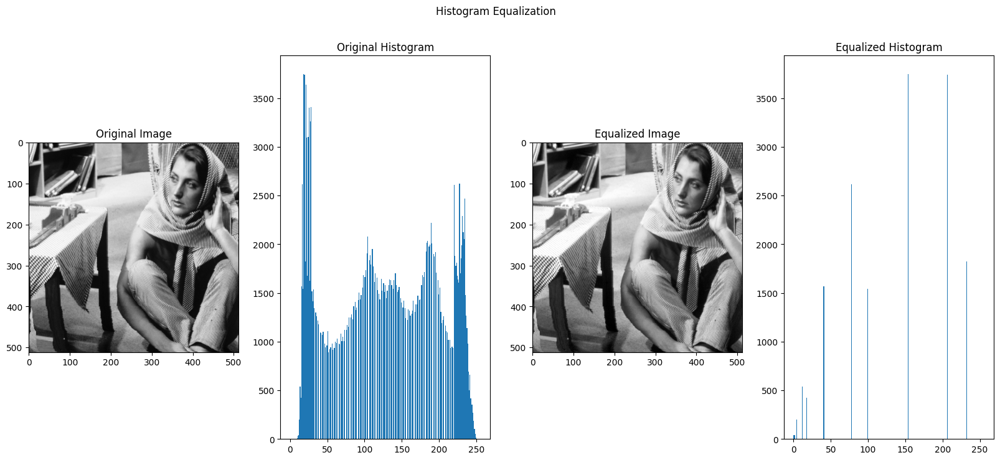

In [50]:
# Load Barbara image
barbara_img = load_image('barbara.png') 
lena_img = load_image('lena.png')  
hawkes_bay_img = load_image('Unequalized_Hawkes_Bay_NZ.jpg') 

# Task 1: Histogram Equalization
barbara_eq, hist_eq = histogram_equalization(barbara_img)
lena_eq, lena_hist_eq = histogram_equalization(lena_img)
hawkes_bay_eq, hawkes_bay_hist_eq = histogram_equalization(hawkes_bay_img)

plot_histogram_equalization(barbara_img, barbara_eq, hist_eq)
# plot_histogram_equalization(lena_img, lena_eq, lena_hist_eq)
# plot_histogram_equalization(hawkes_bay_img, hawkes_bay_eq, hawkes_bay_hist_eq)

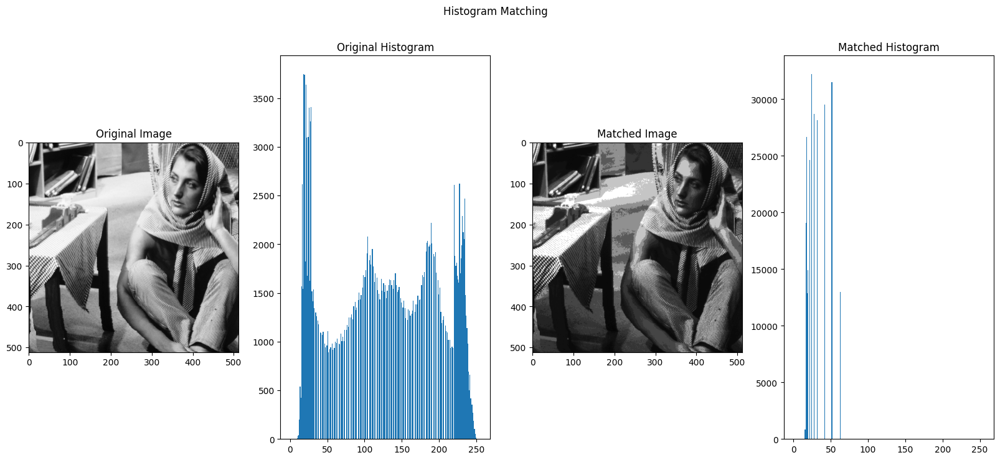

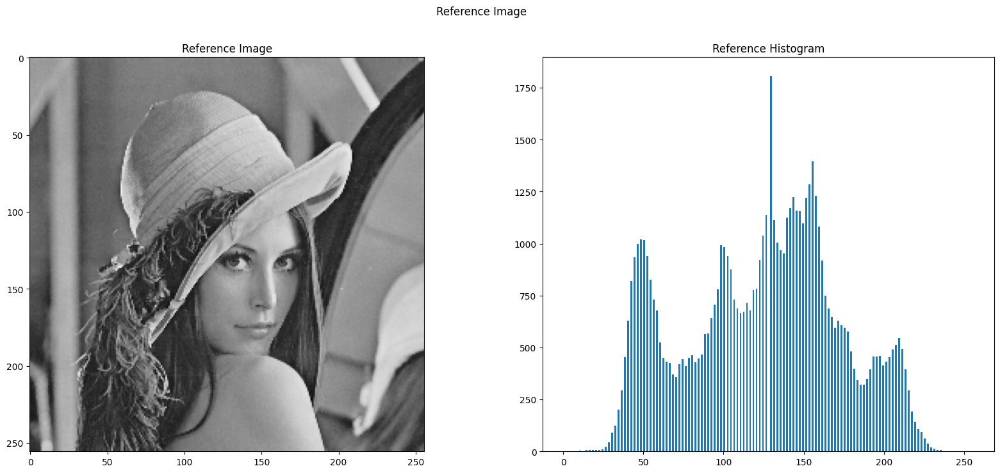

In [53]:
# Task 2: Histogram Matching
barbara_matched, hist_match = histogram_matching(barbara_img, lena_eq)
plot_histogram_matching(barbara_img, barbara_matched, lena_img, hist_match)

# barbara_matched, hist_match = histogram_matching(barbara_img, hawkes_bay_eq)
# plot_histogram_matching(barbara_img, barbara_matched, hawkes_bay_img, hist_match)

# lena_matched, hist_match = histogram_matching(lena_img, barbara_eq)
# plot_histogram_matching(lena_img, lena_matched, barbara_img, hist_match)

# lena_matched, hist_match = histogram_matching(lena_img, hawkes_bay_eq)
# plot_histogram_matching(lena_img, lena_matched, hawkes_bay_img, hist_match)

Elapsed time (simple): 0.021407365798950195
Number of operations for simple convolution: 2359296

Elapsed time (separable): 0.014284372329711914
Number of operations for spatial separable convolution: 1572864


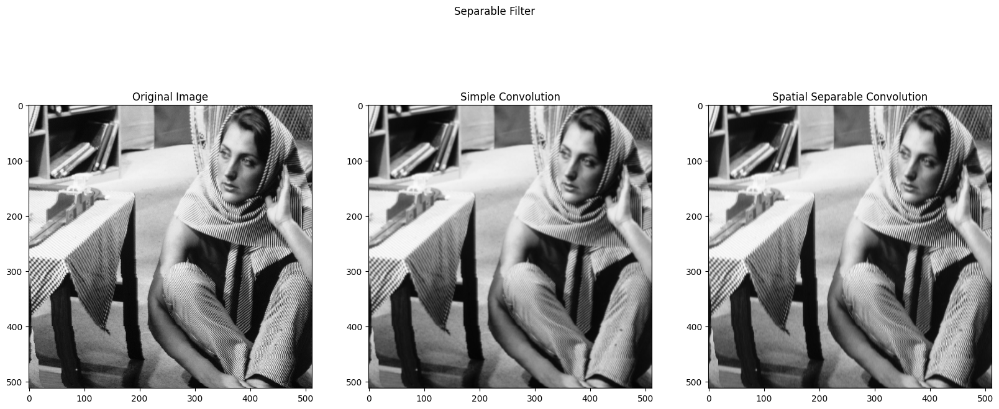

In [149]:
# Task 3: Separable Filter
kernel_3x3 = np.array([[3, 6, 9], [4, 8, 12], [5, 10, 15]])
kernel_3x1 = np.array([3, 4, 5]).reshape((3, 1))
kernel_1x3 = np.array([1, 2, 3]).reshape((1, 3))

perform_convolution(barbara_img, kernel_3x3, kernel_3x1, kernel_1x3)
# perform_convolution(lena_img, kernel_3x3, kernel_3x1, kernel_1x3)
# perform_convolution(hawkes_bay_img, kernel_3x3, kernel_3x1, kernel_1x3)

SNR for Gaussian Noise with 0.01 variance: 9.46 dB
SNR for Salt_pepper Noise with 0.01 variance: 13.70 dB
SNR for Gaussian Noise with 0.1 variance: 0.78 dB
SNR for Salt_pepper Noise with 0.1 variance: 3.84 dB
SNR for Gaussian Noise with 0.2 variance: -1.24 dB
SNR for Salt_pepper Noise with 0.2 variance: 0.82 dB
SNR for Gaussian Noise with 0.5 variance: -3.19 dB
SNR for Salt_pepper Noise with 0.5 variance: -3.15 dB
SNR for Gaussian Noise with 0.7 variance: -3.71 dB
SNR for Salt_pepper Noise with 0.7 variance: -4.61 dB
SNR for Gaussian Noise with 0.9 variance: -4.04 dB
SNR for Salt_pepper Noise with 0.9 variance: -5.72 dB
SNR for Gaussian Noise with 1.5 variance: -4.56 dB
SNR for Salt_pepper Noise with 1.5 variance: -6.17 dB
SNR for Gaussian Noise with 3 variance: -5.07 dB
SNR for Salt_pepper Noise with 3 variance: -6.16 dB
SNR for Gaussian Noise with 5 variance: -5.34 dB
SNR for Salt_pepper Noise with 5 variance: -6.16 dB


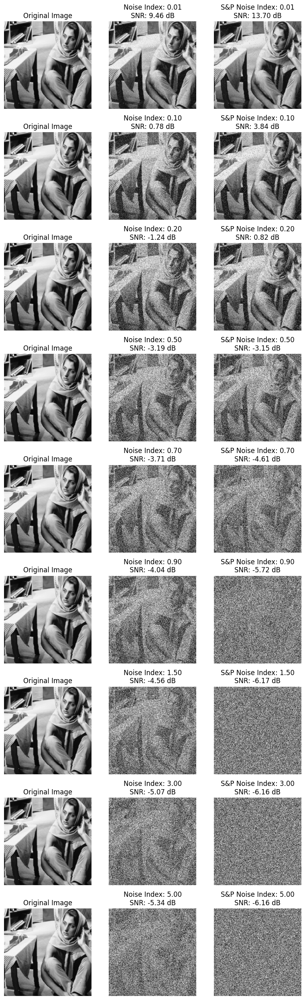

In [145]:
n_values = [0.01, 0.1, 0.2, 0.5, 0.7, 0.9, 1.5, 3, 5]

plot_noise(n_values, barbara_img)
# plot_noise(n_values, lena_img)
# plot_noise(n_values, hawkes_bay_img)

In [228]:
# generate array of matrix sizes
filter_sizes = np.array([3, 5, 7, 9, 11])

# generate array of noise levels
noise_levels = np.array([0.05, 0.2, 0.5, 0.7, 0.8, 0.9, 1.5, 3, 5])

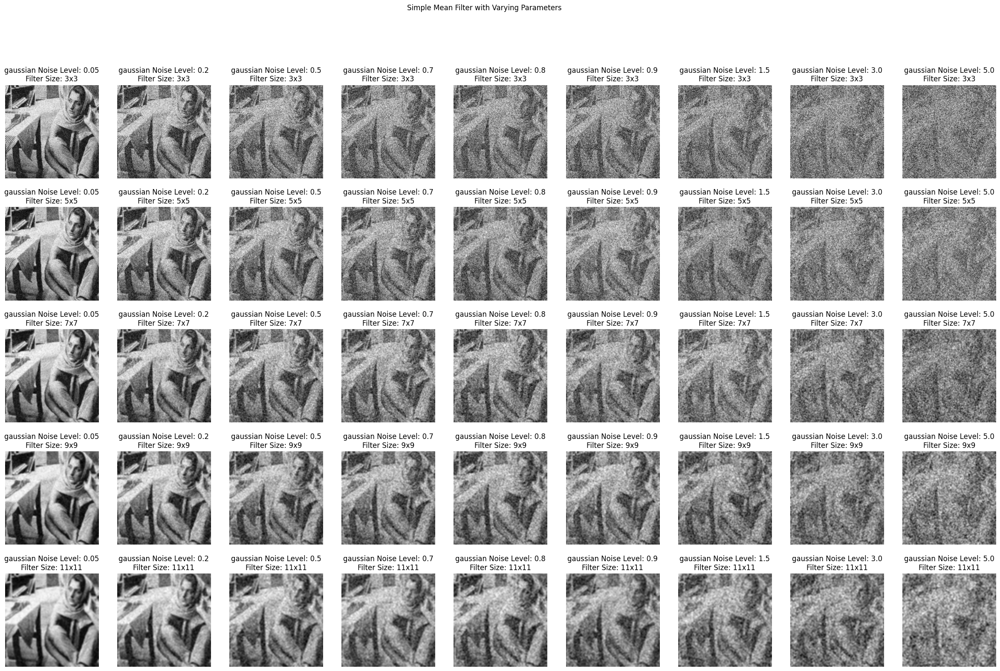

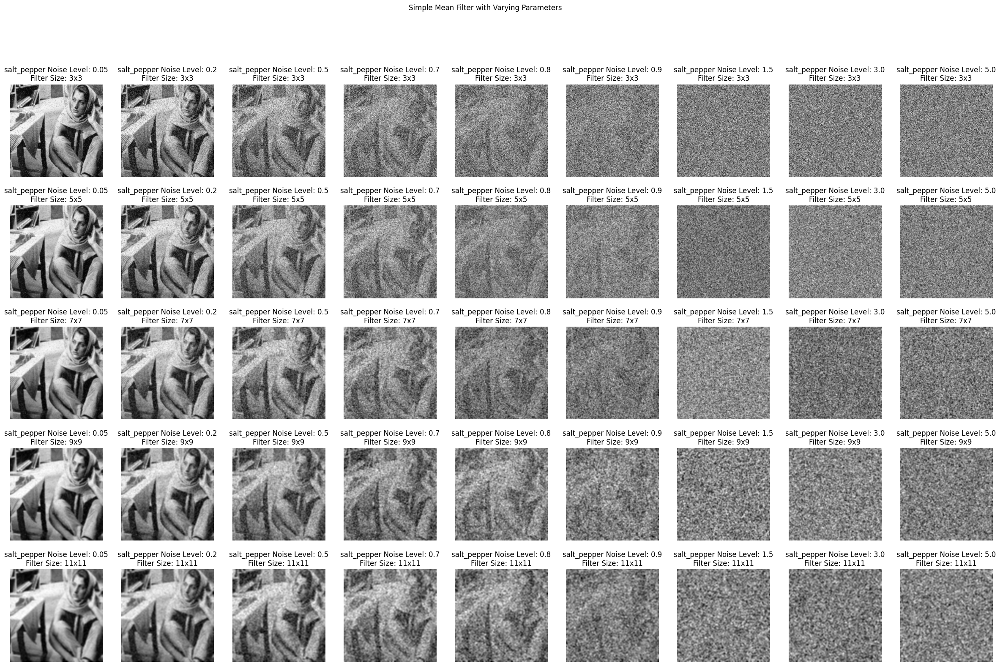

In [231]:
run_mean_filter(barbara_img, filter_sizes, noise_levels, 'gaussian')
run_mean_filter(barbara_img, filter_sizes, noise_levels, 'salt_pepper')

# run_mean_filter(lena_img, filter_sizes, noise_levels, 'gaussian')
# run_mean_filter(lena_img, filter_sizes, noise_levels, 'salt_pepper')

# run_mean_filter(hawkes_bay_img, filter_sizes, noise_levels, 'gaussian')
# run_mean_filter(hawkes_bay_img, filter_sizes, noise_levels, 'salt_pepper')

<ipython-input-230-3d1c5bf67f87>:178: FutureWarning: `selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.
  filtered = median(noisy_img, selem=np.ones((siz, siz)))


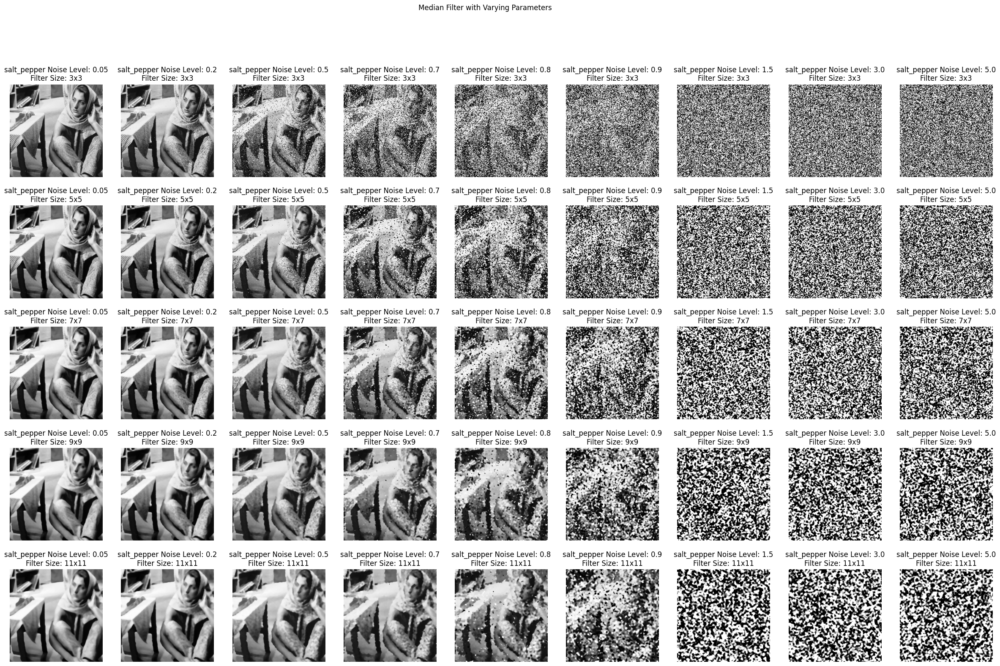

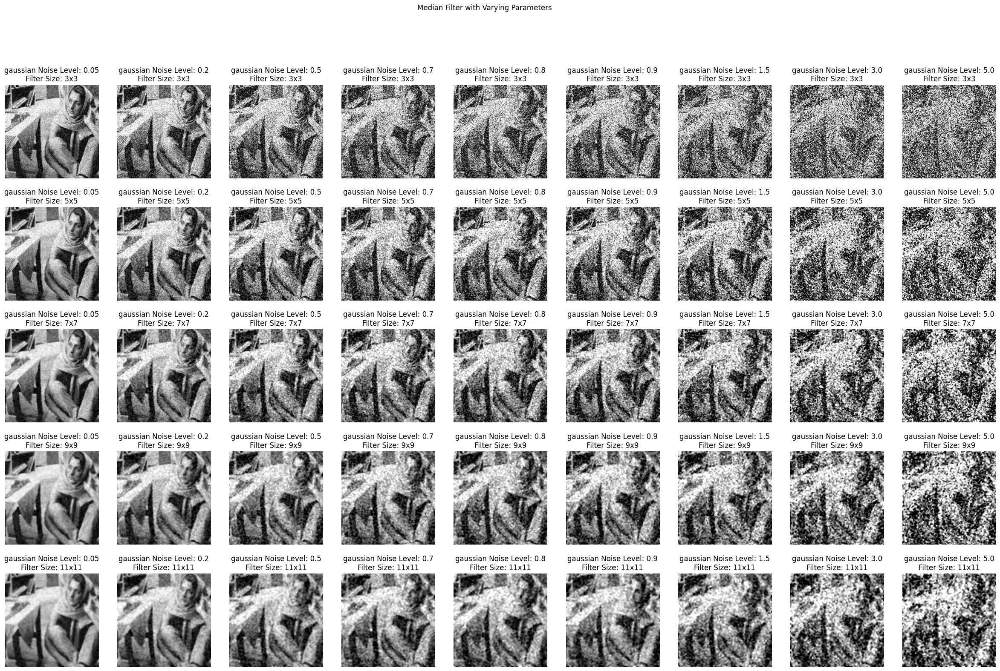

In [232]:
# Task 6: Median Filter
run_median_filter(barbara_img, filter_sizes, noise_levels, 'salt_pepper')
run_median_filter(barbara_img, filter_sizes, noise_levels, 'gaussian')

# run_median_filter(lena_img, filter_sizes, noise_levels, 'salt_pepper')
# run_median_filter(lena_img, filter_sizes, noise_levels, 'gaussian')

# run_median_filter(hawkes_bay_img, filter_sizes, noise_levels, 'salt_pepper')
# run_median_filter(hawkes_bay_img, filter_sizes, noise_levels, 'gaussian')

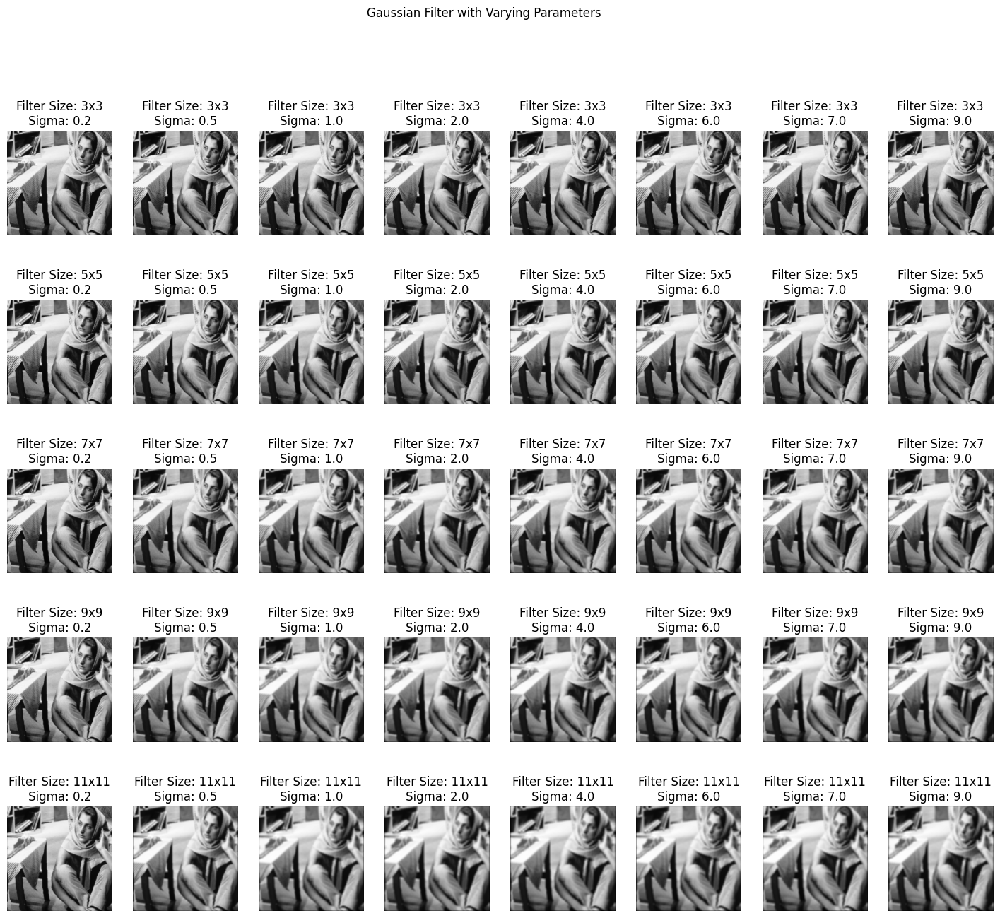

In [233]:
sigmas = [0.2, 0.5, 1, 2, 4, 6, 7, 9]

run_gaussian_filter(barbara_img, filter_sizes, sigmas)

# run_gaussian_filter(lena_img, filter_sizes, sigmas)
# run_gaussian_filter(hawkes_bay_img, filter_sizes, sigmas)